## Trabalho 1

#### 1) Importação das Bibliotecas

In [1]:
# Importação das bibliotecas
import pandas as pd
import plotly as plt
import plotly.express as px
import seaborn as sb
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import numpy as np
import json
from urllib.request import urlopen
import statistics as st

#### 2) Importação da Base de Dados

In [16]:
# Importando o dataset completo
dataset = pd.read_csv('c:/Users/Usuario/Documents/Unicamp/Mestrado/Disciplinas/FT045 - Tópicos em Tecnologia para Informação II/Trabalho 1/dadospnadc.csv', sep = ',')

C:\Users\Usuario\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3165: DtypeWarning:

Columns (3,4,34,44,45,88,89,97,98,100,101,106,107,117,119,121,128,129,131,132,137,138,142,143,144,145,147,148,150,151,152,153,154,155,157,158,172) have mixed types.Specify dtype option on import or set low_memory=False.



In [3]:
# Visualizando as 5 primeiras linhas
dataset.head()

,Ano,Trimestre,UF,Capital,RM_RIDE,UPA,Estrato,V1008,V1014,V1016,...,VD4030,VD4031,VD4032,VD4033,VD4034,VD4035,VD4036,VD4037,Habitual,Efetivo
0,2021,2,Rondônia,Município de Porto Velho (RO),NaN,110000016,1110011,2,8,5,...,"Tinha que cuidar dos afazeres domésticos, do(s...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,1.005071
1,2021,2,Rondônia,Município de Porto Velho (RO),NaN,110000016,1110011,2,8,5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,1.005071
2,2021,2,Rondônia,Município de Porto Velho (RO),NaN,110000016,1110011,3,8,5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,1.005071
3,2021,2,Rondônia,Município de Porto Velho (RO),NaN,110000016,1110011,3,8,5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,1.005071
4,2021,2,Rondônia,Município de Porto Velho (RO),NaN,110000016,1110011,3,8,5,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,1.005071
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
356234,2021,2,Distrito Federal,Município de Brasília (DF),NaN,530057544,5310220,11,8,4,...,NaN,40.0,NaN,NaN,NaN,40.0,40 a 44 horas,40 a 44 horas,1,1.001608
356235,2021,2,Distrito Federal,Município de Brasília (DF),NaN,530057544,5310220,11,8,4,...,NaN,40.0,NaN,NaN,NaN,40.0,40 a 44 horas,40 a 44 horas,1,1.001608
356236,2021,2,Distrito Federal,Município de Brasília (DF),NaN,530057544,5310220,11,8,4,...,Por ser muito jovem ou muito idoso para trabalhar,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,1.001608
356237,2021,2,Distrito Federal,Município de Brasília (DF),NaN,530057544,5310220,12,8,4,...,NaN,44.0,NaN,NaN,NaN,44.0,40 a 44 horas,40 a 44 horas,1,1.001608


#### 3) Seleção das Colunas de Interesse

In [17]:
# Criando um dicionário com os atributos
atributos = {
    'UF': 'Unidade Federativa',
    'V1022': 'Situação do Domicílio',
    'V2001': 'Número de Pessoas no Domicílio',
    'V2007': 'Sexo',
    'V2009': 'Idade',
    'V2010': 'Cor ou Raça',
    'V3001': 'Sabe Ler ou Escrever',
    'V3002': 'Frequenta Escola',
    'V3002A': 'Escola Frequentada',
    'V3003': 'Qual Curso Frequenta (1)',
    'V3003A': 'Qual Curso Frequenta (2)',
    'V4001': 'Trabalhou 1h em Atividade Remunerda',
    'V4003': 'Fez Algum Bico Pelo Menos de 1h',
    'V4009': 'Quantos Trabalhos Tinha na Semana',
    'V4012': 'Posição na Ocupação',
    'V4029': 'Carteira de Trabalho Assinada',
    'V4033': 'Rendimento Habitual (Var. Aux.)',
    'V40331': 'Rendimento Habitual em Dinheiro',
    'V403311': 'Faixa do Valor do Rendimento',
    'V403312': 'Valor do Rendimento',
    'V4071': 'Providência para Conseguir Trabalho'
}





In [18]:
# Filtrando o dataset de acordo com os atributos de interesse
dataset_filtrado = dataset[list(atributos.keys())]
dataset_filtrado.columns = list(atributos.values())

In [6]:
# Visualizando as 5 primeiras linhas
dataset_filtrado = dataset_filtrado.fillna("")
dataset_filtrado.head(10)

,Unidade Federativa,Situação do Domicílio,Número de Pessoas no Domicílio,Sexo,Idade,Cor ou Raça,Sabe Ler ou Escrever,Frequenta Escola,Escola Frequentada,Qual Curso Frequenta (1),...,Trabalhou 1h em Atividade Remunerda,Fez Algum Bico Pelo Menos de 1h,Quantos Trabalhos Tinha na Semana,Posição na Ocupação,Carteira de Trabalho Assinada,Rendimento Habitual (Var. Aux.),Rendimento Habitual em Dinheiro,Faixa do Valor do Rendimento,Valor do Rendimento,Providência para Conseguir Trabalho
0,Rondônia,Urbana,2,Mulher,37,Parda,Não,Não,,,...,Não,Não,,,,,,,,Não
1,Rondônia,Urbana,2,Homem,31,Parda,Sim,Não,,,...,Não,Não,,,,,,,,Sim
2,Rondônia,Urbana,4,Mulher,45,Branca,Sim,Não,,,...,Não,Não,,,,,,,,Sim
3,Rondônia,Urbana,4,Homem,20,Branca,Sim,Não,,,...,Não,Não,,,,,,,,Sim
4,Rondônia,Urbana,4,Homem,8,Branca,Sim,Sim,Rede pública,,...,,,,,,,,,,
5,Rondônia,Urbana,4,Homem,66,Parda,Sim,Não,,,...,Não,Não,,,,,,,,Não
6,Rondônia,Urbana,4,Homem,51,Parda,Sim,Não,,,...,Sim,,Um,Conta própria,,Indica se o quesito foi respondido,Em dinheiro,[1SM]+1 a [2SM],1600.0,
7,Rondônia,Urbana,4,Mulher,45,Parda,Sim,Não,,,...,Não,Não,Um,Trabalhador familiar não remunerado,,,,,,
8,Rondônia,Urbana,4,Homem,26,Parda,Sim,Sim,Rede privada,,...,Sim,,Um,Conta própria,,Indica se o quesito foi respondido,Em dinheiro,"[0,5SM]+1 a [1SM]",1045.0,
9,Rondônia,Urbana,4,Mulher,23,Parda,Sim,Não,,,...,Não,Não,Um,Trabalhador familiar não remunerado,,,,,,


#### 4) Pré-Processamento

In [19]:
# Criando o dataset para a primeira visualização
dataset_visualizacao_1 = dataset_filtrado[['Sabe Ler ou Escrever', 'Valor do Rendimento']].dropna()

In [23]:
# Criando o dataset para a segunda visualização
dataset_visualizacao_2_base = dataset_filtrado[['Situação do Domicílio', 'Número de Pessoas no Domicílio', 'Valor do Rendimento', 'Idade']].dropna()
dataset_visualizacao_2 = dataset_visualizacao_2_base.copy()
dataset_visualizacao_2 = dataset_visualizacao_2.drop_duplicates()
dataset_visualizacao_2 = dataset_visualizacao_2.reset_index(drop = True)

# Separando em rural e urbana
dataset_visualizacao_2_urbana = dataset_visualizacao_2.loc[dataset_visualizacao_2['Situação do Domicílio'] == 'Urbana']
dataset_visualizacao_2_rural = dataset_visualizacao_2.loc[dataset_visualizacao_2['Situação do Domicílio'] == 'Rural']

In [24]:
# Criando o dataset para terceira visualização
dataset_visualizacao_3 = dataset_filtrado[['Número de Pessoas no Domicílio', 'Idade', 'Valor do Rendimento', 'Sexo']]

#### 5) Visualizações

##### 5.1) Visualização 1

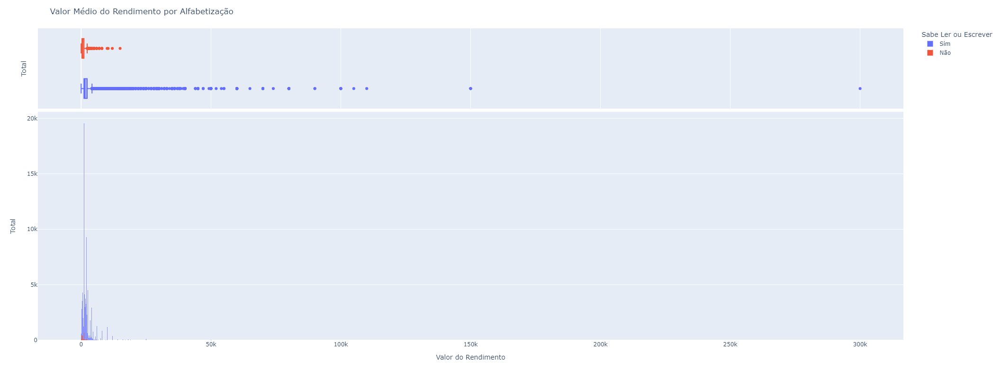

In [21]:
# Visualização 1
fig = px.histogram(dataset_visualizacao_1, x = "Valor do Rendimento", color = "Sabe Ler ou Escrever",
                   marginal = "box", hover_data = dataset_visualizacao_1.columns, barmode = 'overlay', opacity = 0.7)
fig.update_layout(width = 1200, height = 800, title = "Valor Médio do Rendimento por Alfabetização")
fig.update_yaxes(title = "otal")
fig.show()

##### 5.2) Visualização 2

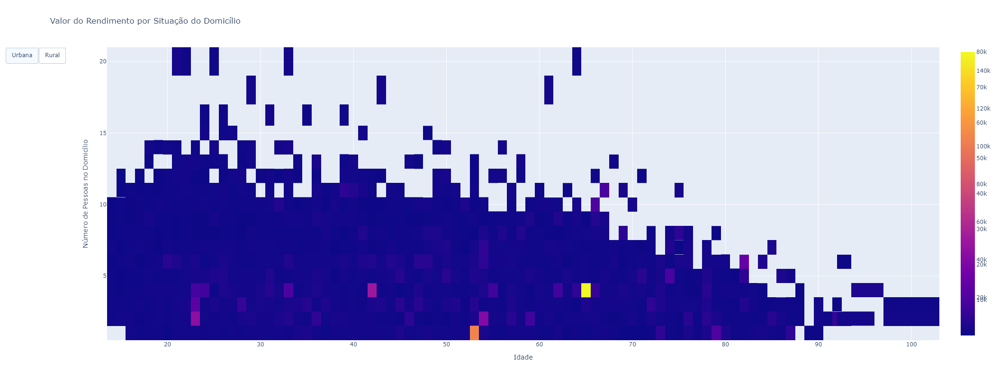

In [25]:
fig = go.Figure(
    data = [
        go.Heatmap(z = dataset_visualizacao_2_urbana['Valor do Rendimento'], 
                   x = dataset_visualizacao_2_urbana["Idade"], 
                   y = dataset_visualizacao_2_urbana["Número de Pessoas no Domicílio"], 
                   name = "Urbana",
                  hoverongaps = False),
        go.Heatmap(z = dataset_visualizacao_2_rural['Valor do Rendimento'], 
                   x = dataset_visualizacao_2_rural["Idade"],
                   y = dataset_visualizacao_2_rural["Número de Pessoas no Domicílio"], 
                   name = "Rural",
                  hoverongaps = False)
    ]
)

fig.update_layout(
    updatemenus = [
        dict(
            type = "buttons",
            direction = "left",
            buttons = list([
                dict(label = "Urbana",
                     method = "update",
                     args = [{"visible": [True, False]},
                           {"title": "Valor do Rendimento por Situação do Domicílio: Urbana",
                            }]),
                dict(label = "Rural",
                     method = "update",
                     args = [{"visible": [False, True]},
                           {"title": "Valor do Rendimento por Situação do Domicílio: Rural",
                            }]),
            ]),
        )
    ])
 
fig.update_layout(
    width = 1200,
    height = 800,
    title = "Valor do Rendimento por Situação do Domicílio"
)

fig.update_xaxes(title = "Idade")
fig.update_yaxes(title = "Número de Pessoas no Domicílio")

fig.show()

##### 5.3) Visualização 3

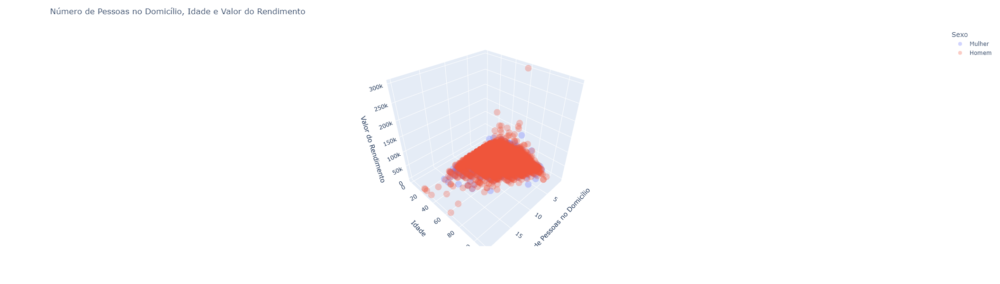

In [27]:
fig = px.scatter_3d(dataset_visualizacao_3, x = 'Número de Pessoas no Domicílio', y = 'Idade', z = 'Valor do Rendimento', color='Sexo', opacity = 0.3)

fig.update_layout(
    width = 800,
    height = 600,
    title = "Número de Pessoas no Domicílio, Idade e Valor do Rendimento",
)

fig.show()